# Introdução

**Nesse primeiro notebook, nosso propósito é fazer uma análise inicial dos dados do dataset de bicicletas compartilhadas de nova iorque e entender suas peculiaridades nos dados.**

Dataset: https://www.kaggle.com/datasets/akkithetechie/new-york-city-bike-share-dataset

Dados Completos da Fonte: https://s3.amazonaws.com/tripdata/index.html

## Próximos Passos

**Análise de Dados:**
* [ ] Análise básica dos dados
* [ ] Limpeza dos dados
* [ ] Visualização de Dados Geográficos
    * [ ] Visualização dos pontos de saída e chegada
* [ ] Calcular distância absoluta de cada estação a outra.
* [ ] Analisar as estações mais populares
* [ ] Analisar os horários de pico e distribuição dos horários geral e por estação
* [ ] Analisar distribuição por dia, mês, ano da semana geral e por estação
* [ ] Analise de sazonalidade
* [ ] Relação do tempo da viagem com a idade e gênero da pessoa
* [ ] Distribuição por estação de idade e gênero
* [ ] Análise de corridas em grupo - mesmo inicio e fim? - pensar como avaliar isso

**Modelos:**
* [ ] Predizer para uma estação, em um dia da semana e horário, quantas corridas terá

**Tempo Real:**
* [ ] Obter dados em tempo real pela API
* [ ] Aplicar o modelo de predição nos dados reais, predizer para próximas horas
* [ ] Criar um dashboard em tempo real

# Importações

In [1]:
import pandas as pd
import plotly.express as px

In [2]:
df_trips = pd.read_csv("Dados/bike_share_data.csv", index_col=0)

In [3]:
from haversine import haversine

# Análise Inicial

Entendendo os tipos de dados e suas distribuições e comportamentos.

In [4]:
df_trips.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 735502 entries, 0 to 12200
Data columns (total 16 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   Trip Duration            735502 non-null  int64  
 1   Start Time               735502 non-null  object 
 2   Stop Time                735502 non-null  object 
 3   Start Station ID         735502 non-null  int64  
 4   Start Station Name       735502 non-null  object 
 5   Start Station Latitude   735502 non-null  float64
 6   Start Station Longitude  735502 non-null  float64
 7   End Station ID           735502 non-null  int64  
 8   End Station Name         735502 non-null  object 
 9   End Station Latitude     735502 non-null  float64
 10  End Station Longitude    735502 non-null  float64
 11  Bike ID                  735502 non-null  int64  
 12  User Type                735502 non-null  object 
 13  Birth Year               735502 non-null  float64
 14  Gende

In [5]:
df_trips.describe()

,Trip Duration,Start Station ID,Start Station Latitude,Start Station Longitude,End Station ID,End Station Latitude,End Station Longitude,Bike ID,Birth Year,Gender,Trip_Duration_in_min
count,7.355020e+05,735502.000000,735502.000000,735502.000000,735502.000000,735502.000000,735502.000000,735502.000000,735502.000000,735502.000000,735502.000000
mean,9.343125e+02,3206.764183,40.723125,-74.046412,3203.387325,40.722371,-74.045415,24914.009133,1979.544239,1.123668,15.570669
std,4.063878e+04,26.546683,0.008121,0.011191,64.358120,0.095296,0.173044,753.768581,9.371192,0.519694,677.312437
min,6.100000e+01,3183.000000,40.692640,-74.096937,147.000000,0.000000,-74.096937,14552.000000,1900.000000,0.000000,1.000000
25%,2.460000e+02,3186.000000,40.717732,-74.050656,3186.000000,40.716540,-74.050444,24486.000000,1975.000000,1.000000,4.000000
50%,3.830000e+02,3202.000000,40.721525,-74.044247,3199.000000,40.721124,-74.043845,24602.000000,1982.000000,1.000000,6.000000
75%,6.520000e+02,3211.000000,40.727596,-74.038051,3211.000000,40.727224,-74.036486,24711.000000,1986.000000,1.000000,11.000000
max,2.026021e+07,3426.000000,40.752559,-74.032108,3442.000000,40.801343,0.000000,29296.000000,2000.000000,2.000000,337670.000000


**Observações de Dados:**

* Máximo de Trip duration muito alta
* Longitude possui valores zerados, indicando trips não finalizadas. Provavelmente vamos dropar.
* Birth Year mínimo de 1900 - precisamos ver a veracidade dessa coluna
* Gender 0, 1, 2 - precisamos verificar os significados
* Trip_Duration_in_min com máximo muito alto
* Nenhum dado nulo no dataset

## Análise de Trip Duration - Semelhante a Trip_Duration_in_min

In [9]:
trip_durations = df_trips["Trip_Duration_in_min"]

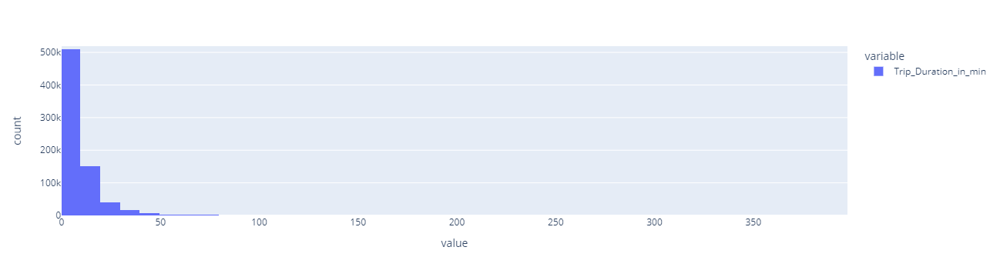

In [10]:
px.histogram(trip_durations, range_x=[0, 10000])

## Análise de Birth Year

In [17]:
birth_years = df_trips["Birth Year"]

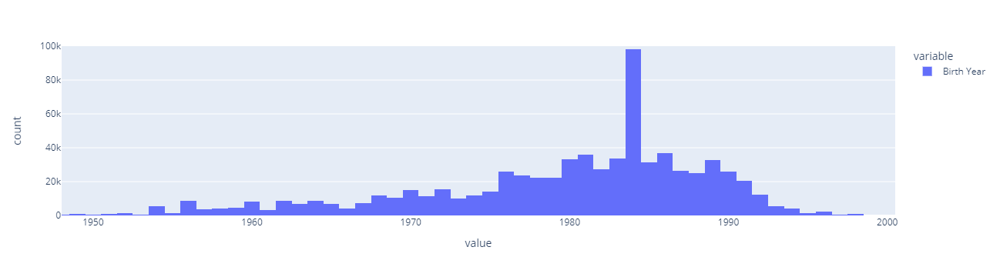

In [18]:
px.histogram(birth_years)

## Unicidade de (latitude, longitude) para cada uma das Stops

Será que os dados de latitude e longitude das stops é consistente ou aparecem múltiplos (lat, long) para um mesmo stop?

In [33]:
# Obtendo as colunas relacionadas a start stops
start_stations = df_trips[['Start Station ID', 'Start Station Latitude', 'Start Station Longitude']]
start_stations.columns = ['Station ID', 'Station Latitude', 'Station Longitude']

In [34]:
# Obtendo as colunas relacionadas a end stops
end_stations = df_trips[['End Station ID', 'End Station Latitude', 'End Station Longitude']]
end_stations.columns = ['Station ID', 'Station Latitude', 'Station Longitude']

In [36]:
# Uniao das stops, ja que ser de inicio ou fim nao importa
stations = pd.concat([start_stations, end_stations], axis=0, ignore_index=True)

In [66]:
stations.head()

,Station ID,Station Latitude,Station Longitude
0,3212,40.734786,-74.050444
1,3207,40.737604,-74.052478
2,3193,40.724605,-74.078406
3,3199,40.728745,-74.032108
4,3183,40.716247,-74.033459


In [59]:
# Verificando se todos os grupos de Station ID possuem apenas 1 linha após dropar duplicatas
(stations.drop_duplicates().groupby("Station ID").size() == 1).all()

True

### Definindo um Dataframe mapeador das stations

Pode ser útil mais tarde termos um mapeador da station id para a lat, long

In [63]:
df_stations = stations.drop_duplicates().set_index('Station ID')

In [64]:
df_stations.head()

,Station Latitude,Station Longitude
Station ID,,
3212,40.734786,-74.050444
3207,40.737604,-74.052478
3193,40.724605,-74.078406
3199,40.728745,-74.032108
3183,40.716247,-74.033459


In [8]:
df_trips[["Start Station Name", "Start Station Latitude", "Start Station Longitude"]].drop_duplicates()

,Start Station Name,Start Station Latitude,Start Station Longitude
0,Christ Hospital,40.734786,-74.050444
1,Oakland Ave,40.737604,-74.052478
2,Lincoln Park,40.724605,-74.078406
3,Newport Pkwy,40.728745,-74.032108
4,Exchange Place,40.716247,-74.033459
5,Heights Elevator,40.748716,-74.040443
6,Hilltop,40.731169,-74.057574
7,North St,40.752559,-74.044725
8,Van Vorst Park,40.718489,-74.047727
9,McGinley Square,40.725340,-74.067622
